In [1]:
!pip install gym matplotlib

***Average reward per thousand episodes***

1000 :  -742.3500000000006


/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


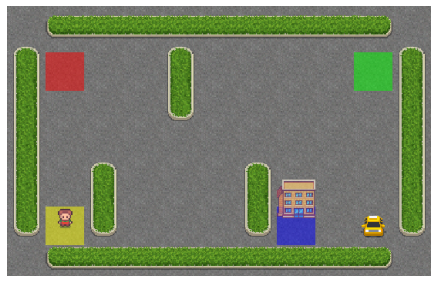

In [2]:
import gym
import numpy as np
import random
import torch
import torch.nn as nn
import torch.optim as optim
from collections import deque
from torch.nn.functional import one_hot
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Setting up the Taxi-v3 environment
env = gym.make("Taxi-v3", new_step_api=True)
env.reset()

# Hyperparameters
state_size = env.observation_space.n
action_size = env.action_space.n
learning_rate = 0.001
max_steps_per_episode = 200
exploration_rate = 1.0
max_exploration_rate = 1.0
min_exploration_rate = 0.01
exploration_decay_rate = 0.001
training_episodes = 100
batch_size = 32

# Adjusting the state representation to one-hot encoding
def one_hot_state(state):
    return one_hot(torch.tensor(state), num_classes=state_size).float()

# DQN Model
class DQN(nn.Module):
    def __init__(self, state_size, action_size):
        super(DQN, self).__init__()
        self.fc1 = nn.Linear(state_size, 24)
        self.fc2 = nn.Linear(24, 24)
        self.fc3 = nn.Linear(24, action_size)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return x

# Instantiate the DQN
model = DQN(state_size, action_size)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
loss_fn = nn.MSELoss()

# Replay buffer
class ReplayBuffer:
    def __init__(self, buffer_size=100000):
        self.buffer = deque(maxlen=buffer_size)

    def add(self, experience):
        self.buffer.append(experience)

    def sample(self, batch_size):
        return random.sample(self.buffer, min(len(self.buffer), batch_size))

replay_buffer = ReplayBuffer()

# Training loop
rewards_all_episodes = []

for episode in range(training_episodes):
    state = env.reset()
    state = one_hot_state(state)
    done = False
    rewards_current_episode = 0

    for step in range(max_steps_per_episode):
        # Exploration-exploitation trade-off
        if random.uniform(0, 1) > exploration_rate:
            with torch.no_grad():
                action = model(state).argmax().item()
        else:
            action = env.action_space.sample()

        new_state, reward, done, truncated, info = env.step(action)
        new_state = one_hot_state(new_state)

        # Store experience in replay buffer
        replay_buffer.add((state, action, reward, new_state, done))

        # Update state
        state = new_state

        # Add rewards
        rewards_current_episode += reward

        if done:
            break

        # Learn from experiences
        if len(replay_buffer.buffer) > batch_size:
            minibatch = replay_buffer.sample(batch_size)
            states, actions, rewards, next_states, dones = zip(*minibatch)
            states = torch.cat(states).view(len(minibatch), -1)
            actions = torch.tensor(actions)
            rewards = torch.tensor(rewards, dtype=torch.float32)
            next_states = torch.cat(next_states).view(len(minibatch), -1)
            dones = torch.tensor(dones, dtype=torch.float32)

            # Compute Q values
            current_q_values = model(states).gather(1, actions.unsqueeze(-1)).squeeze(-1)
            next_q_values = model(next_states).max(1)[0]
            expected_q_values = rewards + (0.99 * next_q_values * (1 - dones))

            # Loss and optimization
            loss = loss_fn(current_q_values, expected_q_values.detach())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    # Exploration rate decay
    exploration_rate = min_exploration_rate + \
                       (max_exploration_rate - min_exploration_rate) * \
                       np.exp(-exploration_decay_rate * episode)

    rewards_all_episodes.append(rewards_current_episode)

# Calculate and print the average reward per thousand episodes
rewards_per_thousand_episodes = np.split(np.array(rewards_all_episodes), training_episodes/100)
count = 1000
print("***Average reward per thousand episodes***\n")
for r in rewards_per_thousand_episodes:
    print(count, ": ", str(sum(r/100)))
    count += 100

# Function to display the animation of frames
def show_frames(frames):
    plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi=72)
    patch = plt.imshow(frames[0])
    plt.axis('off')

    def animate(i):
        patch.set_data(frames[i])

    anim = animation.FuncAnimation(plt.gcf(), animate, frames=len(frames), interval=50)
    return HTML(anim.to_jshtml())

# Test the model and capture frames
def test_agent():
    env = gym.make("Taxi-v3", new_step_api=True)
    total_test_episodes = 1
    max_steps = 99
    frames = []

    for episode in range(total_test_episodes):
        state = env.reset()
        state = one_hot_state(state)

        for step in range(max_steps):
            frames.append(env.render(mode="rgb_array"))
            action = model(state).argmax().item()
            new_state, reward, done, truncated, _ = env.step(action)
            state = one_hot_state(new_state)
            if done:
                break

    env.close()
    return show_frames(frames)

# Display the results of the test
test_agent()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
